# Efeitos de áudio e reprodução com o IPython

  - Transformações de efeito, como: 
      - separação de fontes harmônicas/percussivas, 
      - alongamento de tempo e 
      - mudança de afinação
  - Decompor e reconstruir sinais de áudio com fatoração de matriz não negativa

In [21]:
import librosa
import librosa.display
import IPython.display
import numpy as np

In [22]:
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline

In [23]:
y, sr = librosa.load(librosa.util.example_audio_file())

In [24]:
IPython.display.Audio(data=y, rate=sr)

# Separando o Harmonico e Percusivo

In [25]:
y_h, y_p = librosa.effects.hpss(y)

In [26]:
# Harmonico
IPython.display.Audio(data=y_h, rate=sr)

In [27]:
# Percursivo
IPython.display.Audio(data=y_p, rate=sr)

# Mudando o Pitch em um terço maior (4 semitons)

In [28]:
y_shift = librosa.effects.pitch_shift(y, sr, 7)

IPython.display.Audio(data=y_shift, rate=sr)

# Alogando o periodo de tempo

In [29]:
y_slow = librosa.effects.time_stretch(y, 0.5)

IPython.display.Audio(data=y_slow, rate=sr)

# Decompor um espectrograma

In [30]:
D = librosa.stft(y)

# Separar magnitude e a fase
S, phase = librosa.magphase(D)

components, activations = librosa.decompose.decompose(S, n_components=8, sort=True)

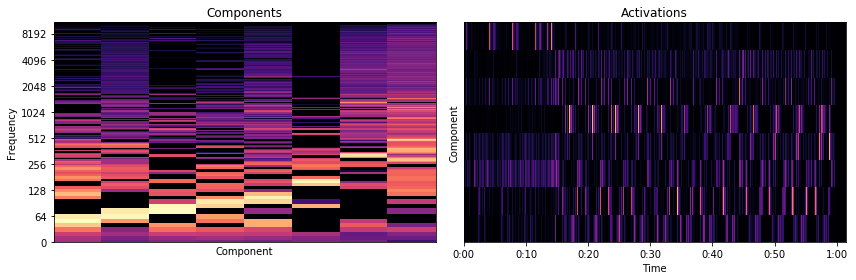

In [31]:
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
librosa.display.specshow(librosa.amplitude_to_db(np.abs(components), ref=np.max), y_axis='log')
plt.xlabel('Component')
plt.ylabel('Frequency')
plt.title('Components')

plt.subplot(1,2,2)
librosa.display.specshow(activations, x_axis='time')
plt.xlabel('Time')
plt.ylabel('Component')
plt.title('Activations')

plt.tight_layout()

In [32]:
print(components.shape, activations.shape)

(1025, 8) (8, 2647)


# Recontruir o espectrograma

In [33]:
D_k = components.dot(activations)

y_k = librosa.istft(D_k * phase)

print('Full reconstruction')

IPython.display.Audio(data=y_k, rate=sr)

Full reconstruction


# Isolar o componente menor

In [34]:
k = 0

D_k = np.multiply.outer(components[:, k], activations[k])

y_k = librosa.istft(D_k * phase)

print('Component #{}'.format(k))

IPython.display.Audio(data=y_k, rate=sr)

Component #0


# Isolar o componente de uma frequencia

In [35]:
k = len(activations) // 2

D_k = np.multiply.outer(components[:, k], activations[k])

y_k = librosa.istft(D_k * phase)

print('Component #{}'.format(k))

IPython.display.Audio(data=y_k, rate=sr)

Component #4


# Isolar o componente mais auto

In [36]:
k = -1

D_k = np.multiply.outer(components[:, k], activations[k])

y_k = librosa.istft(D_k * phase)

print('Component #{}'.format(k))

IPython.display.Audio(data=y_k, rate=sr)

Component #-1
